# Week 4 Individual Coding Assignment
This week we're tasked with improving upon a past assignment. I'm choosing to improve upon my Week 3 Assignment, in which I explored household income in LA County District 3 for our group research proposal. I copied my Week 3 notebook as a baseline, and anything I edit or add in here will be labeled with **new for W4**. 

**Goals:** 
- fix my Python errors from last week
- not have to use Excel as a workaround
- make new maps using the new features we learned in 1/29 lecture this week

**Dataframes:** (so I can keep track of them all)
- income: initial CSV from US Census website
- income2: subset of income with less columns and renamed
- income_pct: income2 and the percentages of households in each income category
- district: initial CSV from LA County Census Tracts Viewer website
- district_income_pct: merged dataset between income_pct and district
- tracts: initial geojson from LA County Open Source GIS page
- tracts_dip: merged dataset between tracts and district_income_pct
- unincorp: subset of tracts_dip of just the unincorporated areas of LA County
- unincorp_d3: further subset of unincorp where it's just District 3's unincorporated areas


First, let's bring in the pandas and geopandas libraries.

In [2]:
import pandas as pd
import geopandas as gpd

Next, I'm going to load in the dataset I downloaded from the US Census website. I downloaded [household income in 2021 in LA County](https://data.census.gov/table/ACSDT5Y2021.B19001?q=INCOME%20OF%20los%20angeles%20county&t=Income%20and%20Poverty&g=050XX00US06037$1400000&y=2021&d=ACS%205-Year%20Estimates%20Detailed%20Tables) from the ACS 5-year estimates as a .zip file. Then I used [Chris' tutorial](https://drive.google.com/file/d/11FtRZfg_aEvQi7NUm0Fz_nHqEKrc-_1Z/view?usp=sharing) to split the Geo_ID column to get FIPS codes in Microsoft Excel.

~~I also renamed columns in Microsoft Excel (I forgot I could do this in Python, oops).~~ **new for W4:** I am going to rename these columns in Python! 

Using the code we learned in lecture, I'm importing in the GEO_ID column as a string so that the leading zeros make it in.

In [3]:
income = pd.read_csv(
    'data/FINAL_HouseholdIncome2021_LACounty_Data_CSV.csv',
    dtype=
    {
        'GEO_ID': str
    }
)

# Preliminary Inspection
Using ```shape```, ```head```, and ```info``` to look at the data. There are 2499 rows and 35 columns, and it appears that we did get the leading zeros in for the GEO_ID column.

In [4]:
income.shape

(2499, 36)

In [5]:
income.head()

,GEO_ID,Geographic Area Name,Estimate!!Total:,Margin of Error!!Total:,"Estimate!!Total:!!Less than $10,000","Margin of Error!!Total:!!Less than $10,000","Estimate!!Total:!!$10,000 to $14,999","Margin of Error!!Total:!!$10,000 to $14,999","Estimate!!Total:!!$15,000 to $19,999","Margin of Error!!Total:!!$15,000 to $19,999",...,"Estimate!!Total:!!$75,000 to $99,999","Margin of Error!!Total:!!$75,000 to $99,999","Estimate!!Total:!!$100,000 to $124,999","Margin of Error!!Total:!!$100,000 to $124,999","Estimate!!Total:!!$125,000 to $149,999","Margin of Error!!Total:!!$125,000 to $149,999","Estimate!!Total:!!$150,000 to $199,999","Margin of Error!!Total:!!$150,000 to $199,999","Estimate!!Total:!!$200,000 or more","Margin of Error!!Total:!!$200,000 or more"
0,06037,"Los Angeles County, California",3342811,5387,180980,3750,142812,2810,112340,2741,...,414844,4941,325230,4641,237643,3257,299389,3720,418793,4962
1,06037101110,"Census Tract 1011.10, Los Angeles County, Cali...",1494,123,54,37,126,82,49,46,...,146,69,210,79,134,64,143,83,90,52
2,06037101122,"Census Tract 1011.22, Los Angeles County, Cali...",1372,167,88,74,0,13,7,11,...,158,58,126,57,194,135,168,77,253,83
3,06037101220,"Census Tract 1012.20, Los Angeles County, Cali...",1357,201,78,53,82,39,28,27,...,134,65,116,68,60,35,140,152,112,64
4,06037101221,"Census Tract 1012.21, Los Angeles County, Cali...",1450,287,76,110,107,123,118,76,...,193,109,207,107,33,41,108,93,0,13


## New for W4: Defining columns to keep and renaming columns
I'm not keeping any of the margin of error columns and also not keeping the Geography Name column.


In [6]:
columns_to_keep = ['GEO_ID',
                   'Estimate!!Total:',
                   'Estimate!!Total:!!Less than $10,000',
                   'Estimate!!Total:!!$10,000 to $14,999', 
                   'Estimate!!Total:!!$15,000 to $19,999',
                   'Estimate!!Total:!!$20,000 to $24,999',
                   'Estimate!!Total:!!$25,000 to $29,999', 
                   'Estimate!!Total:!!$30,000 to $34,999', 
                   'Estimate!!Total:!!$35,000 to $39,999',
                   'Estimate!!Total:!!$40,000 to $44,999',
                   'Estimate!!Total:!!$45,000 to $49,999',
                   'Estimate!!Total:!!$50,000 to $59,999',
                   'Estimate!!Total:!!$60,000 to $74,999',
                   'Estimate!!Total:!!$75,000 to $99,999',
                   'Estimate!!Total:!!$100,000 to $124,999',
                   'Estimate!!Total:!!$125,000 to $149,999',
                   'Estimate!!Total:!!$150,000 to $199,999',
                   'Estimate!!Total:!!$200,000 or more']

#make a new dataframe of this subset of columns
income2 = income[columns_to_keep].copy()


In [7]:
income2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2499 entries, 0 to 2498
Data columns (total 18 columns):
 #   Column                                  Non-Null Count  Dtype 
---  ------                                  --------------  ----- 
 0   GEO_ID                                  2499 non-null   object
 1   Estimate!!Total:                        2499 non-null   int64 
 2   Estimate!!Total:!!Less than $10,000     2499 non-null   int64 
 3   Estimate!!Total:!!$10,000 to $14,999    2499 non-null   int64 
 4   Estimate!!Total:!!$15,000 to $19,999    2499 non-null   int64 
 5   Estimate!!Total:!!$20,000 to $24,999    2499 non-null   int64 
 6   Estimate!!Total:!!$25,000 to $29,999    2499 non-null   int64 
 7   Estimate!!Total:!!$30,000 to $34,999    2499 non-null   int64 
 8   Estimate!!Total:!!$35,000 to $39,999    2499 non-null   int64 
 9   Estimate!!Total:!!$40,000 to $44,999    2499 non-null   int64 
 10  Estimate!!Total:!!$45,000 to $49,999    2499 non-null   int64 
 11  Esti

In [8]:
#look at the column names in income2
income2.columns.to_list()

['GEO_ID',
 'Estimate!!Total:',
 'Estimate!!Total:!!Less than $10,000',
 'Estimate!!Total:!!$10,000 to $14,999',
 'Estimate!!Total:!!$15,000 to $19,999',
 'Estimate!!Total:!!$20,000 to $24,999',
 'Estimate!!Total:!!$25,000 to $29,999',
 'Estimate!!Total:!!$30,000 to $34,999',
 'Estimate!!Total:!!$35,000 to $39,999',
 'Estimate!!Total:!!$40,000 to $44,999',
 'Estimate!!Total:!!$45,000 to $49,999',
 'Estimate!!Total:!!$50,000 to $59,999',
 'Estimate!!Total:!!$60,000 to $74,999',
 'Estimate!!Total:!!$75,000 to $99,999',
 'Estimate!!Total:!!$100,000 to $124,999',
 'Estimate!!Total:!!$125,000 to $149,999',
 'Estimate!!Total:!!$150,000 to $199,999',
 'Estimate!!Total:!!$200,000 or more']

In [9]:
#rename this list above
income2.columns = ['GEO_ID',
 'Households',
 'HH_Less_Than_10K',
 'HH_10K_To_14999',
 'HH_15K_To_19999',
 'HH_20K_To_24999',
 'HH_25K_To_29999',
 'HH_30K_To_34999',
 'HH_35K_To_39999',
 'HH_40K_To_44999',
 'HH_45K_To_49999',
 'HH_50K_To_59999',
 'HH_60K_To_74999',
 'HH_75K_To_99999',
 'HH_100K_To_124999',
 'HH_125K_To_149999',
 'HH_150K_To_199999',
 'HH_200K_Or_More']

In [10]:
income2.head(5)

,GEO_ID,Households,HH_Less_Than_10K,HH_10K_To_14999,HH_15K_To_19999,HH_20K_To_24999,HH_25K_To_29999,HH_30K_To_34999,HH_35K_To_39999,HH_40K_To_44999,HH_45K_To_49999,HH_50K_To_59999,HH_60K_To_74999,HH_75K_To_99999,HH_100K_To_124999,HH_125K_To_149999,HH_150K_To_199999,HH_200K_Or_More
0,06037,3342811,180980,142812,112340,121032,119357,122002,115562,116264,102875,216948,296740,414844,325230,237643,299389,418793
1,06037101110,1494,54,126,49,33,61,6,60,85,43,149,105,146,210,134,143,90
2,06037101122,1372,88,0,7,42,50,36,0,13,0,37,200,158,126,194,168,253
3,06037101220,1357,78,82,28,102,7,86,43,55,36,189,89,134,116,60,140,112
4,06037101221,1450,76,107,118,148,0,81,111,27,97,112,32,193,207,33,108,0


In [11]:
#confirm we have no columns that are entirely empty
income2.columns[income2.isna().all()].tolist()

[]

In [12]:
#same as last week, I'm dropping the first row since it's the sum of ALL the households in LA County
income2.drop(index=income2.index[0], axis=0, inplace=True)

In [13]:
income2.head()

,GEO_ID,Households,HH_Less_Than_10K,HH_10K_To_14999,HH_15K_To_19999,HH_20K_To_24999,HH_25K_To_29999,HH_30K_To_34999,HH_35K_To_39999,HH_40K_To_44999,HH_45K_To_49999,HH_50K_To_59999,HH_60K_To_74999,HH_75K_To_99999,HH_100K_To_124999,HH_125K_To_149999,HH_150K_To_199999,HH_200K_Or_More
1,06037101110,1494,54,126,49,33,61,6,60,85,43,149,105,146,210,134,143,90
2,06037101122,1372,88,0,7,42,50,36,0,13,0,37,200,158,126,194,168,253
3,06037101220,1357,78,82,28,102,7,86,43,55,36,189,89,134,116,60,140,112
4,06037101221,1450,76,107,118,148,0,81,111,27,97,112,32,193,207,33,108,0
5,06037101222,935,161,167,34,41,19,116,0,86,14,35,44,96,9,81,0,32


## New for W4: new dataframe with percentages
Last week, I grouped the 16 income category columns into 7 smaller ones.

This week, I want to group them into even *fewer* categories (6 instead of 7), move them to a new dataframe, and *also* calculate the percentage of households in LA County by census tract that fall into those income categories. The 6 base categories: HH_Less_Than_14999, HH_15K_To_44999, HH_45K_To_74999, **keep HH_75K_To_99999,** HH_100K_To_199999, and **keep HH_200K_Or_More**.

In [14]:
#making 4 new groupings + keeping 2 existing ones
income2['HH_Less_Than_14999'] = income2[['HH_Less_Than_10K','HH_10K_To_14999']].sum(axis=1)
income2['HH_15K_To_44999'] = income2[['HH_15K_To_19999','HH_20K_To_24999', 'HH_25K_To_29999', 'HH_30K_To_34999', 'HH_35K_To_39999', 'HH_40K_To_44999']].sum(axis=1)

#revised column 45K to 74.9K compared to week 3, keep existing column 75K to 100K
income2['HH_45K_To_74999'] = income2[['HH_45K_To_49999','HH_50K_To_59999', 'HH_60K_To_74999']].sum(axis=1)
income2['HH_100K_To_199999'] = income2[['HH_100K_To_124999','HH_125K_To_149999','HH_150K_To_199999']].sum(axis=1)

In [15]:
#check looks good
income2.head(5)

,GEO_ID,Households,HH_Less_Than_10K,HH_10K_To_14999,HH_15K_To_19999,HH_20K_To_24999,HH_25K_To_29999,HH_30K_To_34999,HH_35K_To_39999,HH_40K_To_44999,...,HH_60K_To_74999,HH_75K_To_99999,HH_100K_To_124999,HH_125K_To_149999,HH_150K_To_199999,HH_200K_Or_More,HH_Less_Than_14999,HH_15K_To_44999,HH_45K_To_74999,HH_100K_To_199999
1,06037101110,1494,54,126,49,33,61,6,60,85,...,105,146,210,134,143,90,180,294,297,487
2,06037101122,1372,88,0,7,42,50,36,0,13,...,200,158,126,194,168,253,88,148,237,488
3,06037101220,1357,78,82,28,102,7,86,43,55,...,89,134,116,60,140,112,160,321,314,316
4,06037101221,1450,76,107,118,148,0,81,111,27,...,32,193,207,33,108,0,183,485,241,348
5,06037101222,935,161,167,34,41,19,116,0,86,...,44,96,9,81,0,32,328,296,93,90


In [16]:
#make a new dataframe that just has our desired income groupings
income_pct = income2[['GEO_ID', 'Households','HH_Less_Than_14999', 
'HH_15K_To_44999', 'HH_45K_To_74999', 'HH_75K_To_99999', 
'HH_100K_To_199999', 'HH_200K_Or_More']].copy()

In [17]:
income_pct.head(3)

,GEO_ID,Households,HH_Less_Than_14999,HH_15K_To_44999,HH_45K_To_74999,HH_75K_To_99999,HH_100K_To_199999,HH_200K_Or_More
1,06037101110,1494,180,294,297,146,487,90
2,06037101122,1372,88,148,237,158,488,253
3,06037101220,1357,160,321,314,134,316,112


In [18]:
#NEW percentage columns
income_pct['HH_Less_Than_14999_PCT'] = income_pct['HH_Less_Than_14999']/income_pct['Households']*100
income_pct['HH_15K_To_44999_PCT'] = income_pct['HH_15K_To_44999']/income_pct['Households']*100
income_pct['HH_45K_To_74999_PCT'] = income_pct['HH_45K_To_74999']/income_pct['Households']*100
income_pct['HH_75K_To_99999_PCT'] = income_pct['HH_75K_To_99999']/income_pct['Households']*100
income_pct['HH_100K_To_199999_PCT'] = income_pct['HH_100K_To_199999']/income_pct['Households']*100
income_pct['HH_200K_Or_More_PCT'] = income_pct['HH_200K_Or_More']/income_pct['Households']*100

In [19]:
#let's check - looks good
income_pct.head()

,GEO_ID,Households,HH_Less_Than_14999,HH_15K_To_44999,HH_45K_To_74999,HH_75K_To_99999,HH_100K_To_199999,HH_200K_Or_More,HH_Less_Than_14999_PCT,HH_15K_To_44999_PCT,HH_45K_To_74999_PCT,HH_75K_To_99999_PCT,HH_100K_To_199999_PCT,HH_200K_Or_More_PCT
1,06037101110,1494,180,294,297,146,487,90,12.048193,19.678715,19.879518,9.772423,32.597055,6.024096
2,06037101122,1372,88,148,237,158,488,253,6.413994,10.787172,17.274052,11.516035,35.568513,18.440233
3,06037101220,1357,160,321,314,134,316,112,11.790715,23.655122,23.139278,9.874724,23.286662,8.253500
4,06037101221,1450,183,485,241,193,348,0,12.620690,33.448276,16.620690,13.310345,24.000000,0.000000
5,06037101222,935,328,296,93,96,90,32,35.080214,31.657754,9.946524,10.267380,9.625668,3.422460


In the .rename command, the "inplace = True" is also new for W4, only because I just noticed that the FIPS column wasn't staying put as the name when I ran .head again.

In [20]:
#rename the GEO_ID column to FIPS so we can merge later
income_pct.rename(columns = {'GEO_ID':'FIPS'}, inplace = True)

In [21]:
income_pct.head()

,FIPS,Households,HH_Less_Than_14999,HH_15K_To_44999,HH_45K_To_74999,HH_75K_To_99999,HH_100K_To_199999,HH_200K_Or_More,HH_Less_Than_14999_PCT,HH_15K_To_44999_PCT,HH_45K_To_74999_PCT,HH_75K_To_99999_PCT,HH_100K_To_199999_PCT,HH_200K_Or_More_PCT
1,06037101110,1494,180,294,297,146,487,90,12.048193,19.678715,19.879518,9.772423,32.597055,6.024096
2,06037101122,1372,88,148,237,158,488,253,6.413994,10.787172,17.274052,11.516035,35.568513,18.440233
3,06037101220,1357,160,321,314,134,316,112,11.790715,23.655122,23.139278,9.874724,23.286662,8.253500
4,06037101221,1450,183,485,241,193,348,0,12.620690,33.448276,16.620690,13.310345,24.000000,0.000000
5,06037101222,935,328,296,93,96,90,32,35.080214,31.657754,9.946524,10.267380,9.625668,3.422460


## Bringing in LA County Supervisorial Districts
This week, I wanted to bring in all my datasets before I started mapping instead of piecemeal like I did it last week. Furthermore, I'm going to get *all* the Supervisorial Districts so I have it all on hand. I can subset to just District 3 later. Once again, this CSV is from [LA County Census Tracts Viewer](https://www.arcgis.com/apps/dashboards/e928d021b4d74e5ab4537fac43a3eaf5).

Also, I realized last week that I didn't read in the 'CT20' column as a string, *and* I accidentally referenced the wrong dataset when I was making the FIPS column. I'm hoping that by correcting those issues this week, I won't run into the errors I did last week.

In [22]:
district = pd.read_csv(
    'data/All_LA_Census_Tracts_By_Supervisorial_District_2020.csv',
    dtype=
    {
        'CT20': str
    }
)

In [23]:
#CT20 is indeed an object!
district.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2495 entries, 0 to 2494
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    2495 non-null   int64  
 1   Join_Count     2495 non-null   int64  
 2   TARGET_FID     2495 non-null   int64  
 3   CT20           2495 non-null   object 
 4   LABEL          2495 non-null   float64
 5   NAME           2495 non-null   object 
 6   SUP_NAME       2495 non-null   object 
 7   DIST_SUP       2495 non-null   int64  
 8   CITYNAME_ALF   2262 non-null   object 
 9   NAME_1         283 non-null    object 
 10  JURISDICTION   2495 non-null   object 
 11  AREA_NUM       2495 non-null   int64  
 12  AREA_NAME      2495 non-null   object 
 13  Shape__Area    2495 non-null   float64
 14  Shape__Length  2495 non-null   float64
dtypes: float64(3), int64(5), object(7)
memory usage: 292.5+ KB


In [24]:
# make the FIPS code column
district['FIPS'] = '06' + '037' + district['CT20']

In [25]:
district.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2495 entries, 0 to 2494
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    2495 non-null   int64  
 1   Join_Count     2495 non-null   int64  
 2   TARGET_FID     2495 non-null   int64  
 3   CT20           2495 non-null   object 
 4   LABEL          2495 non-null   float64
 5   NAME           2495 non-null   object 
 6   SUP_NAME       2495 non-null   object 
 7   DIST_SUP       2495 non-null   int64  
 8   CITYNAME_ALF   2262 non-null   object 
 9   NAME_1         283 non-null    object 
 10  JURISDICTION   2495 non-null   object 
 11  AREA_NUM       2495 non-null   int64  
 12  AREA_NAME      2495 non-null   object 
 13  Shape__Area    2495 non-null   float64
 14  Shape__Length  2495 non-null   float64
 15  FIPS           2495 non-null   object 
dtypes: float64(3), int64(5), object(8)
memory usage: 312.0+ KB


### First merge: income_pct with district

In [26]:
district_income_pct = district.merge(income_pct, on = "FIPS")

In [27]:
district_income_pct.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2495 entries, 0 to 2494
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   OBJECTID_12             2495 non-null   int64  
 1   Join_Count              2495 non-null   int64  
 2   TARGET_FID              2495 non-null   int64  
 3   CT20                    2495 non-null   object 
 4   LABEL                   2495 non-null   float64
 5   NAME                    2495 non-null   object 
 6   SUP_NAME                2495 non-null   object 
 7   DIST_SUP                2495 non-null   int64  
 8   CITYNAME_ALF            2262 non-null   object 
 9   NAME_1                  283 non-null    object 
 10  JURISDICTION            2495 non-null   object 
 11  AREA_NUM                2495 non-null   int64  
 12  AREA_NAME               2495 non-null   object 
 13  Shape__Area             2495 non-null   float64
 14  Shape__Length           2495 non-null   

## Bringing in the census tracts themselves
No changes from last week. This is still the GeoJSON from the [LA County GIS Hub that Chris sent](https://egis-lacounty.hub.arcgis.com/datasets/339787e096f94c2dbfbf1909698d6c5c/explore). I'm going to read it in, make a FIPS column, and then merge it with ```district_income_pct```.

In [28]:
tracts = gpd.read_file('data/2020_Census_Tracts.geojson')

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


In [29]:
tracts.info()
tracts['FIPS'] ='06' + '037' + tracts['CT20']

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       2496 non-null   int64   
 1   CT20           2496 non-null   object  
 2   LABEL          2496 non-null   object  
 3   ShapeSTArea    2496 non-null   float64 
 4   ShapeSTLength  2496 non-null   float64 
 5   geometry       2496 non-null   geometry
dtypes: float64(2), geometry(1), int64(1), object(2)
memory usage: 117.1+ KB


In [30]:
tracts.head(3)

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,FIPS
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220


### Second merge: tracts with district_income_pct

In [31]:
tracts_dip = tracts.merge(district_income_pct, on = 'FIPS')

In [32]:
tracts_dip.head()

,OBJECTID,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,geometry,FIPS,OBJECTID_12,Join_Count,TARGET_FID,...,HH_45K_To_74999,HH_75K_To_99999,HH_100K_To_199999,HH_200K_Or_More,HH_Less_Than_14999_PCT,HH_15K_To_44999_PCT,HH_45K_To_74999_PCT,HH_75K_To_99999_PCT,HH_100K_To_199999_PCT,HH_200K_Or_More_PCT
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110,1,1,1,...,297,146,487,90,12.048193,19.678715,19.879518,9.772423,32.597055,6.024096
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122,2,1,2,...,237,158,488,253,6.413994,10.787172,17.274052,11.516035,35.568513,18.440233
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220,3,1,3,...,314,134,316,112,11.790715,23.655122,23.139278,9.874724,23.286662,8.253500
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,4,1,4,...,241,193,348,0,12.620690,33.448276,16.620690,13.310345,24.000000,0.000000
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222,5,1,5,...,93,96,90,32,35.080214,31.657754,9.946524,10.267380,9.625668,3.422460


## Top 10 census tracts of various household incomes
**By count of households:**
- Less than 14,999: 4 were in D3 City of LA, 2 were in D3 City of Santa Monica, and 1 each in D5 Lancaster, D3 WeHo, D4 Long Beach, D5 Palmdale
- 15K to 44,999: 3 in D3 WeHo, 3 in D5 Glendale. 1 each in D2 LA, D4 Paramount, D5 Palmdale, and D2 Inglewood. 
- $45K to$74,999: 5 in D4 Long Beach. 1 each in D4 Torrance, D3 Santa Monica, D3 LA, D5 unincorporated Antelope Valley, and D1 Covina
- \$75K t $99,999: 3 in D4 Long Beach, 3 in D3 WeHo. 1 each in D2 Culver City, D2 Hawthorne, D4 Torrance, and D5 Pasaden
-  \$100K o $199,999: 2 in D2 LA, 2 in D4 Long Beach, 2 in D5 Santa Clarita. 1 each in D2 unincorporated Marina del Rey, D1 LA (different district), D3 Santa Monica, and D3 WeHo.- \$200K or more: 2 in D3 Santa Monica. 1 each in D2 LA, D2 unincorporated Marina del Rey, D2 Hermosa Beach, D3 LA, D5 Santa Clarita, D4 Palos Verdes Estates, D2 Redondo Beach, and D4 Rancho Palos Vers:**


In [33]:
# sort values by census tracts with the greatest number of households with income under $14,999
# output 6 columns and the top 10 census tracts
tracts_dip.sort_values(by = 'HH_Less_Than_14999', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_Less_Than_14999', 'HH_Less_Than_14999_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_Less_Than_14999,HH_Less_Than_14999_PCT
595,06037207304,1,LOS ANGELES,NaN,1003,59.952182
602,06037207502,1,LOS ANGELES,NaN,944,39.580713
2472,06037701402,3,SANTA MONICA,NaN,896,24.137931
2278,06037900806,5,LANCASTER,NaN,817,37.322979
2473,06037701902,3,SANTA MONICA,NaN,805,25.531240
2198,06037700102,3,WEST HOLLYWOOD,NaN,789,27.860169
630,06037209300,1,LOS ANGELES,NaN,714,33.600000
2012,06037576200,4,LONG BEACH,NaN,705,22.211720
2317,06037910501,5,PALMDALE,NaN,705,34.107402
588,06037206301,1,LOS ANGELES,NaN,696,65.475071


In [34]:
tracts_dip.sort_values(by = 'HH_15K_To_44999', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_15K_To_44999', 'HH_15K_To_44999_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_15K_To_44999,HH_15K_To_44999_PCT
2199,06037700200,3,WEST HOLLYWOOD,NaN,1193,27.622135
836,06037234902,2,LOS ANGELES,NaN,968,50.025840
1881,06037553802,4,PARAMOUNT,NaN,928,44.766040
2317,06037910501,5,PALMDALE,NaN,862,41.702951
1111,06037301601,5,GLENDALE,NaN,853,37.510994
2200,06037700300,3,WEST HOLLYWOOD,NaN,846,21.336696
2050,06037600902,2,INGLEWOOD,NaN,837,36.758893
1129,06037302401,5,GLENDALE,NaN,832,30.906389
1110,06037301502,5,GLENDALE,NaN,830,34.670008
2197,06037700101,3,WEST HOLLYWOOD,NaN,828,23.765786


In [35]:
tracts_dip.sort_values(by = 'HH_45K_To_74999', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_45K_To_74999', 'HH_45K_To_74999_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_45K_To_74999,HH_45K_To_74999_PCT
2159,06037650604,4,TORRANCE,NaN,887,33.534972
2220,06037701801,3,SANTA MONICA,NaN,800,28.139289
2452,06037576601,4,LONG BEACH,NaN,783,30.173410
472,06037191000,3,LOS ANGELES,NaN,764,25.543297
2011,06037575902,4,LONG BEACH,NaN,754,24.843493
2256,06037900104,5,NaN,ANTELOPE VALLEY,744,41.797753
2451,06037576001,4,LONG BEACH,NaN,739,21.078152
2012,06037576200,4,LONG BEACH,NaN,717,22.589792
1296,06037406103,1,COVINA,NaN,714,25.310174
2027,06037577100,4,LONG BEACH,NaN,706,20.832104


In [36]:
tracts_dip.sort_values(by = 'HH_75K_To_99999', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_75K_To_99999', 'HH_75K_To_99999_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_75K_To_99999,HH_75K_To_99999_PCT
2235,06037703003,2,CULVER CITY,NaN,714,22.291602
2027,06037577100,4,LONG BEACH,NaN,695,20.507524
2076,06037602106,2,HAWTHORNE,NaN,692,30.865299
2176,06037651222,4,TORRANCE,NaN,689,28.541839
2491,06037577300,4,LONG BEACH,NaN,661,17.721180
1483,06037463601,5,PASADENA,NaN,660,20.183486
2451,06037576001,4,LONG BEACH,NaN,650,18.539646
2201,06037700400,3,WEST HOLLYWOOD,NaN,640,21.527077
2199,06037700200,3,WEST HOLLYWOOD,NaN,604,13.984719
2200,06037700300,3,WEST HOLLYWOOD,NaN,600,15.132409


In [37]:
tracts_dip.sort_values(by = 'HH_100K_To_199999', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_100K_To_199999', 'HH_100K_To_199999_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_100K_To_199999,HH_100K_To_199999_PCT
2233,06037702900,2,NaN,MARINA DEL REY,1796,34.525183
1020,06037275604,2,LOS ANGELES,NaN,1681,36.567327
606,06037207902,1,LOS ANGELES,NaN,1612,41.038697
2491,06037577300,4,LONG BEACH,NaN,1385,37.131367
2475,06037702102,3,SANTA MONICA,NaN,1180,31.559240
1022,06037276000,2,LOS ANGELES,NaN,1138,39.623955
2451,06037576001,4,LONG BEACH,NaN,1123,32.030804
2387,06037920121,5,SANTA CLARITA,NaN,1111,35.804061
2200,06037700300,3,WEST HOLLYWOOD,NaN,1102,27.793190
2396,06037920329,5,SANTA CLARITA,NaN,1100,40.500736


In [38]:
tracts_dip.sort_values(by = 'HH_200K_Or_More', ascending = False)[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1', 'HH_200K_Or_More', 'HH_200K_Or_More_PCT']].head(10)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1,HH_200K_Or_More,HH_200K_Or_More_PCT
1020,06037275604,2,LOS ANGELES,NaN,1965,42.745269
2233,06037702900,2,NaN,MARINA DEL REY,1715,32.968089
2461,06037621104,2,HERMOSA BEACH,NaN,1113,34.597451
2438,06037262604,3,LOS ANGELES,NaN,1104,52.124646
2387,06037920121,5,SANTA CLARITA,NaN,1072,34.547212
2472,06037701402,3,SANTA MONICA,NaN,1054,28.394397
2466,06037670324,4,PALOS VERDES ESTATES,NaN,1034,49.783341
2137,06037620701,2,REDONDO BEACH,NaN,1026,34.803256
2196,06037670702,4,RANCHO PALOS VERDES,NaN,1023,50.171653
2471,06037701304,3,SANTA MONICA,NaN,1006,34.369662


## Making a dataset of just unincorporated LA County
I wanted to keep both the "Unincorporated Area" and "Incorporated/Unincorporated" types in the Jurisidiction column just in case. I found code help on [the Internet](https://www.listendata.com/2019/07/how-to-filter-pandas-dataframe.html) that finally helped me translate the SQL syntax of ```select * from tracts_dip where JURISIDICTION in("UNINCORPORATED AREA", "INCORPORATED/UNINCORPORATED")``` into Python format.

In [39]:
unincorp = tracts_dip[tracts_dip.JURISDICTION.isin(["UNINCORPORATED AREA", "INCORPORATED/UNINCORPORATED"])]

In [40]:
unincorp[['FIPS', 'DIST_SUP', 'CITYNAME_ALF', 'NAME_1']].sample(5)

,FIPS,DIST_SUP,CITYNAME_ALF,NAME_1
1254,06037403802,5,NaN,CHARTER OAK
1601,06037503000,4,NaN,SOUTH WHITTIER - SUNSHINE ACRES
1728,06037535102,2,NaN,FLORENCE - FIRESTONE
98,06037113231,3,NaN,WEST CHATSWORTH
1290,06037405701,1,NaN,EAST IRWINDALE


## Making a dataset of unincorp D3

In [41]:
unincorp_d3 = unincorp[unincorp.DIST_SUP == 3]
unincorp_d3.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 14 entries, 98 to 2481
Data columns (total 35 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   OBJECTID                14 non-null     int64   
 1   CT20_x                  14 non-null     object  
 2   LABEL_x                 14 non-null     object  
 3   ShapeSTArea             14 non-null     float64 
 4   ShapeSTLength           14 non-null     float64 
 5   geometry                14 non-null     geometry
 6   FIPS                    14 non-null     object  
 7   OBJECTID_12             14 non-null     int64   
 8   Join_Count              14 non-null     int64   
 9   TARGET_FID              14 non-null     int64   
 10  CT20_y                  14 non-null     object  
 11  LABEL_y                 14 non-null     float64 
 12  NAME                    14 non-null     object  
 13  SUP_NAME                14 non-null     object  
 14  DIST_SUP              

# Maps (geopandas)
Moment of truth if I fixed my errors last week....I did!!

<Axes: >

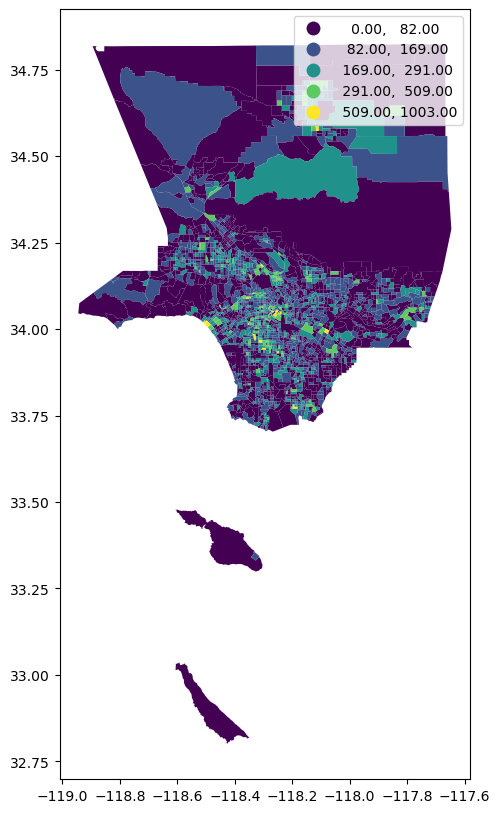

In [42]:
tracts_dip.plot(figsize=(12,10),
                 column='HH_Less_Than_14999',
                 legend=True, 
                 scheme='NaturalBreaks')

<Axes: >

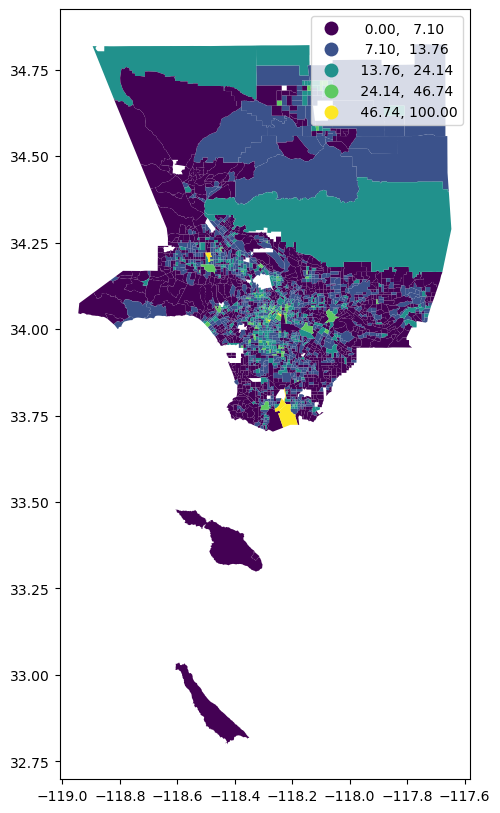

In [43]:
#let's make one by percentage. Tried different schemes. I attempted to play with 'legend with keywords' but it didn't always play nice
tracts_dip.plot(figsize=(12,10),
                 column='HH_Less_Than_14999_PCT',
                 legend=True,
                 #legend_kwds = {'label': 'Percentage of Households in Census Tract with Income Below $14,999', 'orientation': 'horizontal'})
                 #scheme='equal_interval'
                scheme='NaturalBreaks'
                #scheme='quantiles'
               )

## Maps (Folium with branca) to make popups and tooltips

Chris touched upon this a bit last week but I didn't get around to experimenting with the popups and tooltips in Folium combined with branca last week. I'm working off of [this guide](https://python-visualization.github.io/folium/latest/user_guide/geojson/geojson_popup_and_tooltip.html).

In [44]:
import folium
import branca

In [45]:
# initiate the colormap from the branca library
colormap = branca.colormap.LinearColormap(
    vmin=unincorp['HH_Less_Than_14999'].quantile(0.0), #leftbound of the color scale
    vmax=unincorp['HH_Less_Than_14999'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Number of Households with Income Below $14,999 in the Unincorporated Areas of LA County",
)

In [46]:
# now to make the map in folium -- let's make one with tooltips first
m = folium.Map(location=[34.2,-118.2], #where LA County is
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the tooltip that will go into the map 
tooltip = folium.GeoJsonTooltip(
    fields=['NAME_1', 'DIST_SUP', 'HH_Less_Than_14999'], #columns from unincorp, but idk how it knows it's from there 
    aliases=["Unincorporated Area:", 'Supervisorial District:', 'Number of Households w Income < $15K:'], #how i want it to display
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """, #this styling of the tooltip box is from the guide and i left it as is
    max_width=800,
)

#making the GeoJson map
folium.GeoJson(
    unincorp,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["HH_Less_Than_14999"]) #idk what properties is
        if x["properties"]["HH_Less_Than_14999"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opcaity for now
    },
    
    tooltip=tooltip, #idk why this isn't a rogue comma
).add_to(m)

colormap.add_to(m)

m

A map with tooltips!!!! It looks cool.

In [47]:
m.save('LA_Unincorp_HH_Less_Than_14999.html')

Now I'm going to make a second map called mp with popups and leverage the existing colormap from branca.

In [48]:
# now to make the map in folium -- let's make one with tooltips first
mp = folium.Map(location=[34.2,-118.2], #where LA County is
               zoom_start = 10, #zoom in on places not in district 5
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['NAME_1', 'HH_Less_Than_14999'], #columns from unincorp, but idk how it knows it's from there 
    aliases=["Unincorporated Area:", 'Number of Households w Income < $15K:'], #how i want it to display
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    unincorp,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["HH_Less_Than_14999"]) #idk what properties is
        if x["properties"]["HH_Less_Than_14999"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opcaity for now
    },
    
    popup=popup, #idk why this isn't a rogue comma
).add_to(mp)

colormap.add_to(mp)

mp

In [49]:
mp.save('LA_Unincorp_HH_Less_Than_14999_popup.html')

## Maps (matplotlib, contextily, plotly)
Let's try some of the new maps that were covered in W4. Start by importing the libraries.

In [50]:
import matplotlib.pyplot as plt
import contextily as ctx
import plotly.express as px #for interactive plots

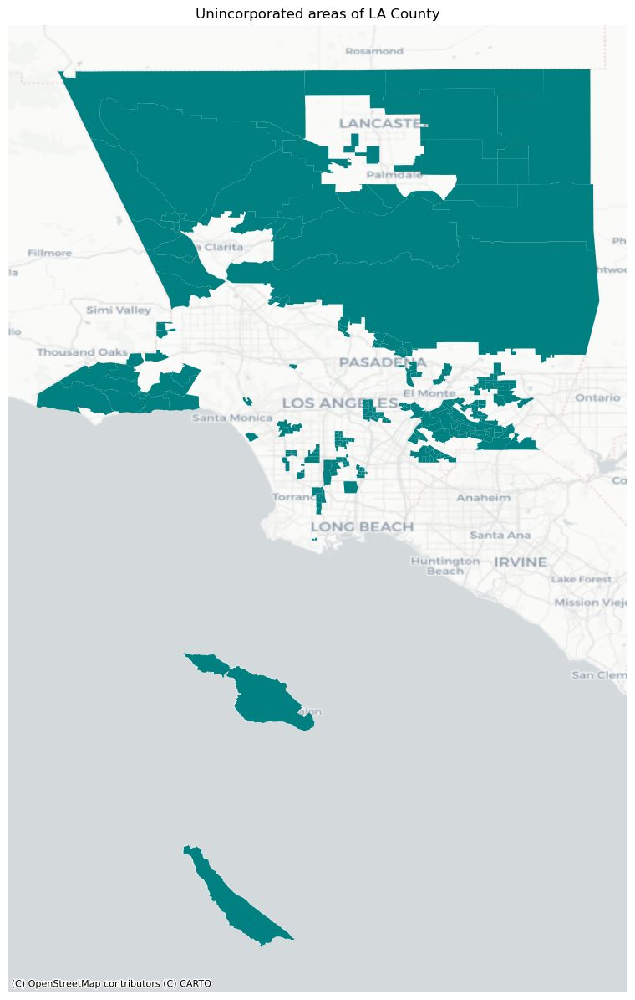

In [51]:
# start the plot in matplotlib.pyplot, then add the basemap from contextily
fig, ax = plt.subplots(figsize=(15, 15))

# add the data options...I don't think I technically have markers
unincorp.plot(ax=ax, 
        marker='X',
        markersize=2,
        color='teal'
             )

ax.axis('off') # turn the axes off
ax.set_title('Unincorporated areas of LA County')

ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=4326) # note that we must specify the projection here (crs)

Moving into plotly stacked bar charts...according to the [plotly documentation](https://plotly.com/python/bar-charts/), the income data I've got is in wide-form data format, where each of the household income categories are in its own column. Going to try and make this work accordingly.

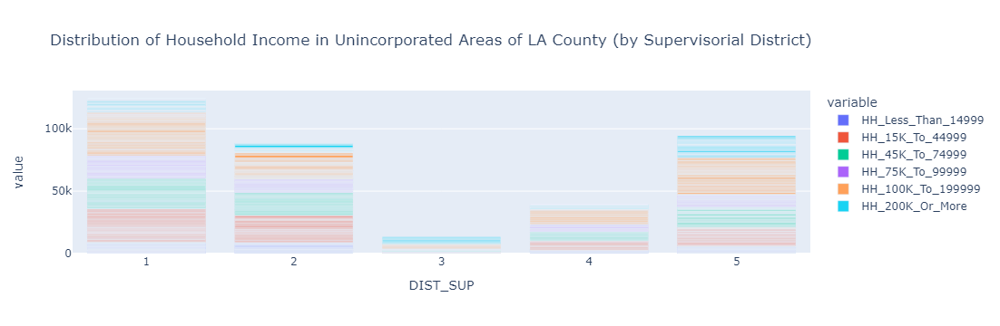

In [52]:
# this did not exactly work the way i expected. why is the background grey?  what if i flip it the other way?
fig = px.bar(unincorp,
       x='DIST_SUP',
       y=['HH_Less_Than_14999', 'HH_15K_To_44999', 'HH_45K_To_74999', 'HH_75K_To_99999', 'HH_100K_To_199999', 'HH_200K_Or_More'],
       title = 'Distribution of Household Income in Unincorporated Areas of LA County (by Supervisorial District)'
)

fig.show()

According to that same plotly documentation above, I can get rid of the stripey-ness by just changing from a ```.bar``` graph to a ```.histogram``` graph, weirdly enough.

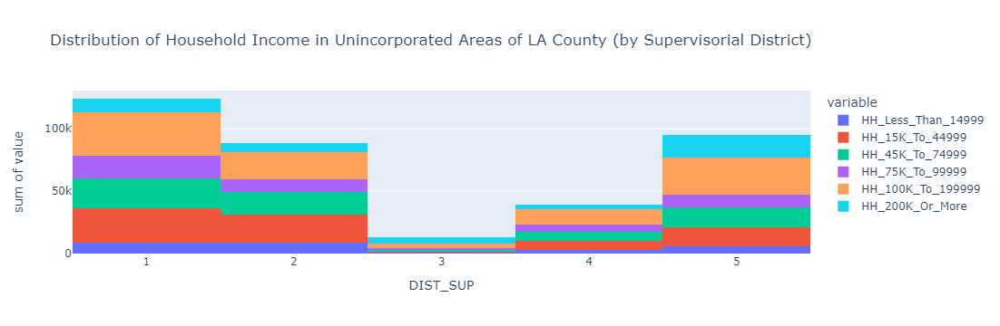

In [53]:
# why does this work?!
fig = px.histogram(unincorp,
       x='DIST_SUP',
       y=['HH_Less_Than_14999', 'HH_15K_To_44999', 'HH_45K_To_74999', 'HH_75K_To_99999', 'HH_100K_To_199999', 'HH_200K_Or_More'],
       title = 'Distribution of Household Income in Unincorporated Areas of LA County (by Supervisorial District)'
)

fig.show()

Those bar graphs above look cool, but I'm not sure it's telling me very much except that perhaps District 3 just doesn't have a lot of people living in unincorporated areas. Since the ```unincorp``` dataset is much smaller, I wonder if I can plot by area name.

The answer is yes, it just still doesn't look very good.

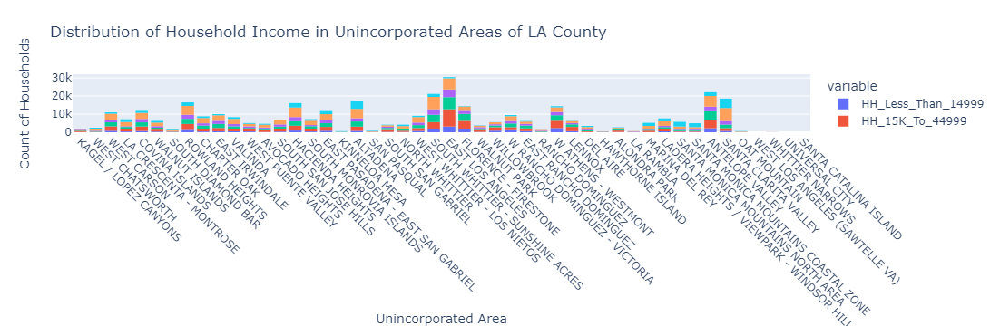

In [54]:
fig = px.histogram(unincorp,
       x='NAME_1',
       y=['HH_Less_Than_14999', 'HH_15K_To_44999', 'HH_45K_To_74999', 'HH_75K_To_99999', 'HH_100K_To_199999', 'HH_200K_Or_More'],
                   #labels={'NAME_1':'Unincorporated Area'}, #this works for renaming the x-axis but I don't know how to do it for the y-axis with a bunch
                   title = 'Distribution of Household Income in Unincorporated Areas of LA County'
)

#some code I found on the internet to make my graph a little prettier
fig.update_xaxes(tickangle=45) 
fig.update_layout(xaxis_title='Unincorporated Area', yaxis_title='Count of Households')

fig.show()

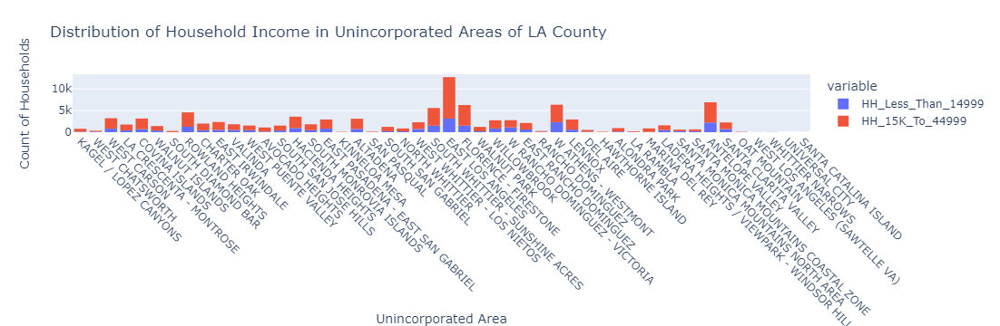

In [55]:
fig = px.histogram(unincorp,
       x='NAME_1',
       y=['HH_Less_Than_14999', 'HH_15K_To_44999'],
                   #labels={'NAME_1':'Unincorporated Area'}, #this works for renaming the x-axis but I don't know how to do it for the y-axis with a bunch
                   title = 'Distribution of Household Income in Unincorporated Areas of LA County'
)

#some code I found on the internet to make my graph a little prettier
fig.update_xaxes(tickangle=45) 
fig.update_layout(xaxis_title='Unincorporated Area', yaxis_title='Count of Households')

fig.show()

### Broken plotly express choropleth maps
We covered scatter plots in plotly in class, but I think my data probably works better with a choropleth map. I attempted to look up how to make these on the [plotly documentation](https://plotly.com/python/choropleth-maps/) and from [StackOverflow](https://stackoverflow.com/questions/65507374/plotting-a-geopandas-dataframe-using-plotly), and tried so many alternatives, but this map looks cursed no matter what I do.

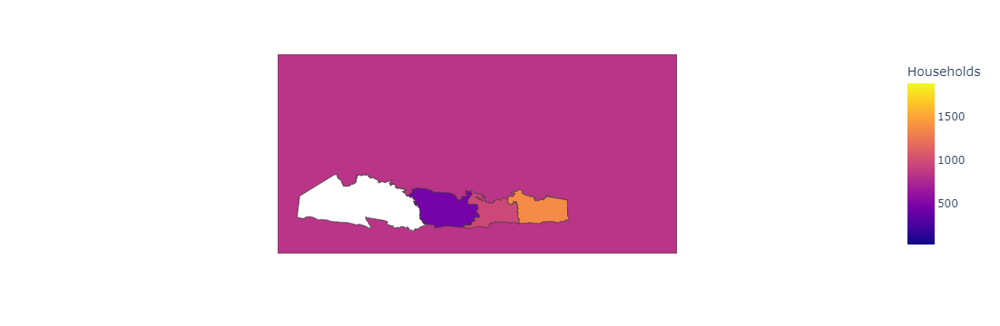

In [57]:

#fig = px.choropleth(tracts_dip, 
#                    geojson=tracts_dip.geometry, 
 #                   locations= tracts_dip.FIPS, 
  #                  color="HH_Less_Than_14999",
   #                 projection = "mercator"
    #               )
#fig.update_geos(fitbounds="locations", visible=False)
#fig.show()

#fig = px.choropleth(tracts_dip,
#                    geojson = tracts_dip.geometry,
 #                   locations = 'FIPS',
  #                  color = 'HH_Less_Than_14999',
   #                 hover_name = 'NAME_1',
    #                labels={"NAME_1": "Name of Unincorporated Area"},
     #               color_continuous_scale="Viridis")
#fig.show()

                    
fig = px.choropleth(unincorp_d3, geojson=unincorp_d3.geometry, locations=unincorp_d3.index, color="Households")
fig.update_geos(fitbounds="locations", visible=False)

fig.show() #i give up

## Importing Parks Data

I got caught up in fixing my map issues and playing with new maps that I forgot I wanted to import in a new dataset. I haven't actually looked at the LA County Parks yet, so I'm going to bring in a geojson from the **[County of LA website](https://egis-lacounty.hub.arcgis.com/datasets/lacounty::countywide-parks-and-open-space-public-hosted/about).**

In [58]:
parks = gpd.read_file('data/Countywide_Parks_and_Open_Space_(Public_-_Hosted).geojson')
parks.head(5)  

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
0,1,30.0,23603.0,El Barrio Park,El Barrio Park,Open Access,2.093,2.092992,"Claremont, City of",City,...,-117.704423,400 Claremont Blvd,Claremont,91711,None,None,No,9.117036e+04,1451.547906,"POLYGON ((-117.70383 34.09747, -117.70421 34.0..."
1,2,56.0,NaN,El Dorado Park,El Dorado Park,Open Access,5.144,5.143217,"Lancaster, City of",City,...,-118.122109,44501 5th St E,Lancaster,93535,None,None,No,2.240376e+05,2192.277128,"POLYGON ((-118.12252 34.69275, -118.12252 34.6..."
2,3,62.0,3000015.0,Atlantic Avenue Park,Atlantic Avenue Park,Open Access,1.960,1.959610,"Los Angeles, County of",County,...,-118.155201,570 S. Atlantic Blvd.,Los Angeles,90022,March 1st to October 31st<br>\nOperating Hours...,General/Aquatics: (323) 260-2341; Reservations...,Yes,8.536029e+04,1139.269960,"POLYGON ((-118.15541 34.02582, -118.15540 34.0..."
3,4,72.0,22715.0,El Escorpion Park,El Escorpion Park,Open Access,66.914,66.338029,"Los Angeles, City of",City,...,-118.664169,6801 Sunset Ridge Ct,West Hills,91307,None,(818) 883-6641,No,2.889673e+06,7761.831975,"POLYGON ((-118.66713 34.19881, -118.66714 34.1..."
4,5,78.0,22860.0,El Marino Park/ El Marino Elementary,El Marino Park Elementary/El Marino Park,Open Access,3.200,1.650439,"Culver City, City of",City,...,-118.399233,11450 Port Rd,Culver City,90230,None,None,No,7.189283e+04,1215.415276,"POLYGON ((-118.39909 33.99221, -118.39910 33.9..."


In [59]:
parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3012 entries, 0 to 3011
Data columns (total 53 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       3012 non-null   int64   
 1   UNIT_ID        3011 non-null   float64 
 2   LMS_ID         1263 non-null   float64 
 3   PARK_NAME      3012 non-null   object  
 4   PARK_LBL       3012 non-null   object  
 5   ACCESS_TYP     3012 non-null   object  
 6   RPT_ACRES      3012 non-null   float64 
 7   GIS_ACRES      3012 non-null   float64 
 8   AGNCY_NAME     3012 non-null   object  
 9   AGNCY_LEV      3012 non-null   object  
 10  AGNCY_TYP      3012 non-null   object  
 11  AGNCY_WEB      3010 non-null   object  
 12  MNG_AGENCY     3012 non-null   object  
 13  COGP_TYP       3011 non-null   object  
 14  NDS_AN_TYP     3009 non-null   object  
 15  NEEDS_ANLZ     3010 non-null   object  
 16  TKIT_SUM       3010 non-null   object  
 17  AMEN_RPT       3010 non-n

In [61]:
# finding out what all these columns mean
parks[['PARK_NAME', 'AM_OPNSP', 'AM_TRLS', 'TRLS_MI', 'TENIS', 'BSKTB', 'SK8PK', 'TOTAL_GOOD', 'TOTAL_FAIR', 'TOTAL_POOR', 'TYPE', 'IS_COUNTY']].sample(5)

,PARK_NAME,AM_OPNSP,AM_TRLS,TRLS_MI,TENIS,BSKTB,SK8PK,TOTAL_GOOD,TOTAL_FAIR,TOTAL_POOR,TYPE,IS_COUNTY
2202,Selma Park,Present - Good,None,0.0,0.0,0.0,0.0,1.0,0.0,0.0,Local Park,No
1319,Sepulveda Rec. Center,Present - Fair,Present - Fair,0.0,4.0,1.0,0.0,7.0,7.0,0.0,Local Park,No
167,Limekiln Canyon Park,None,Present - Fair,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Local Park,No
766,San Jose Creek,Not Reported,Not Reported,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Regional Open Space,No
2326,Maurice 'Mossy' Kent Park,Present - Good,Not Reported,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Local Park,No


I think I only want the parks managed by the County, because that mimics how unincorporated areas of LA are also managed by the County.

In [63]:
parks[parks['IS_COUNTY'] == 'Yes']

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
2,3,62.0,3000015.0,Atlantic Avenue Park,Atlantic Avenue Park,Open Access,1.960000,1.959610,"Los Angeles, County of",County,...,-118.155201,570 S. Atlantic Blvd.,Los Angeles,90022,March 1st to October 31st<br>\nOperating Hours...,General/Aquatics: (323) 260-2341; Reservations...,Yes,8.536029e+04,1139.269960,"POLYGON ((-118.15541 34.02582, -118.15540 34.0..."
42,43,948.0,3000087.0,George Lane Park,George Lane Park,Open Access,13.667000,13.664533,"Los Angeles, County of",County,...,-118.228522,5520 W. Ave. L-8,Lancaster,93536,Operating Hours<br>\n6:30am to 9:00pm<br>\nMon...,General: (661) 722-7780; Reservations: (800) 2...,Yes,5.952247e+05,3150.231875,"POLYGON ((-118.22759 34.65281, -118.22753 34.6..."
48,49,1063.0,3000068.0,Gloria Heer Park,Gloria Heer Park,Open Access,10.360000,10.359808,"Los Angeles, County of",County,...,-117.912973,18109 E. Gallineta St.,Rowland Heights,91748,March 1st to October 31st<br>\nOperating Hours...,General: (626) 333-1369; Reservations: (888) 2...,Yes,4.512714e+05,2827.016453,"POLYGON ((-117.91152 33.97858, -117.91153 33.9..."
60,61,1282.0,3000005.0,Adventure Park,Adventure Park,Open Access,14.597000,14.598150,"Los Angeles, County of",County,...,-118.035193,10130 S. Gunn Ave.,Whittier,90605,Operating Hours<br>\nMonday – Sunday<br>\r\n6:...,General: (562) 698-7645; Reservations: (800) 4...,Yes,6.358929e+05,3687.070862,"POLYGON ((-118.03457 33.94388, -118.03457 33.9..."
92,93,2142.0,3000017.0,Bassett Park,Bassett Park,Open Access,9.787000,9.787420,"Los Angeles, County of",County,...,-117.986823,510 N. Vineland Ave.,La Puente,91746,Operating Hours<br>\n6:30am to 9:00pm<br>\nMon...,General: (626) 333-0959; Reservations: (888) 2...,Yes,4.263383e+05,2841.798605,"POLYGON ((-117.98674 34.05217, -117.98644 34.0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3007,3009,6970.0,3000052.0,Eaton Canyon Natural Area and Nature Center,Eaton Canyon Park and Nature Ctr.,Open Access,219.087769,219.087769,"Los Angeles, County of",County,...,-118.096038,1750 N. Altadena Dr.,Pasadena,91001,March 1st to October 31st<br>\nOperating Hours...,General: (626) 398-5420,Yes,9.543472e+06,46367.511401,"MULTIPOLYGON (((-118.09584 34.18610, -118.0960..."
3008,3010,6229.0,3000074.0,"Earvin ""Magic"" Johnson Recreation Area",Earvin 'Magic' Johnson Rec. Area,Open Access,120.660000,120.660543,"Los Angeles, County of",County,...,-118.260350,905 E. El Segundo Blvd.,Los Angeles,90059,Operating Hours<br>\nMonday – Sunday<br>\n6:30...,General: (323) 942-8457; Reservations: (800) 4...,Yes,5.255955e+06,15742.071556,"MULTIPOLYGON (((-118.25615 33.91651, -118.2564..."
3009,3011,100023.0,3000071.0,Hollywood Bowl,Hollywood Bowl,Open Access,77.430000,77.428979,"Los Angeles, County of",County,...,-118.339429,2301 N. Highland Ave.,Los Angeles,90068,<Null>,General: (323) 850-2060,Yes,3.372794e+06,14811.941036,"MULTIPOLYGON (((-118.33613 34.10801, -118.3362..."
3010,3012,7277.0,3000064.0,William S. Hart Regional Park,William S. Hart Regional Park,Open Access,155.869048,155.869048,"Santa Clarita, City of",City,...,-118.526456,24151 N. Newhall Ave.,Newhall,91321,March 1st to October 31st\nOperating Hours\nTu...,General: (661) 259-1750,Yes,6.789656e+06,14398.274986,"MULTIPOLYGON (((-118.52545 34.37595, -118.5252..."


Let's make a subsetted dataset of the county parks.

In [64]:
county_parks = parks[parks['IS_COUNTY'] == 'Yes'].copy()

In [65]:
county_parks.sample(5)

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
2970,2972,6999.0,3000150.0,Santa Fe Dam Recreational Area,Santa Fe Dam Rec. Area,Open Access,952.381205,952.381205,United States Army Corps of Engineers,Federal,...,-117.949851,15501 E. Arrow Highway,Baldwin Park,91706,March 1st to October 31st<br>\nOperating Hours...,General: (626) 334-1065,Yes,4.148556e+07,40741.475292,"MULTIPOLYGON (((-117.94690 34.12519, -117.9468..."
2948,2949,12696.0,3000162.0,Tujunga Ponds Wildlife Sanctuary,Tujunga Ponds Wildlife Sanctuary,Open Access,826.300000,826.232979,"Los Angeles, City of",City,...,-118.340586,10711-10749 Foothill Fwy,Sunland,91040,<Null>,General: (661) 944-6881,Yes,5.608830e+05,4241.815274,"POLYGON ((-118.33773 34.26709, -118.33773 34.2..."
2943,2944,6782.0,3000144.0,San Dimas Canyon Community Regional Park,San Dimas Canyon Community RP,Open Access,12.250000,12.251248,"Los Angeles, County of",County,...,-117.792461,512 Sycamore Canyon Rd.,San Dimas,91773,Hours of Operation<br>\n6:00 am to 8:00 pm<br>...,General: (888) 239-6700; Reservations: (909) 5...,Yes,5.336622e+05,3785.795499,"POLYGON ((-117.78996 34.12891, -117.78995 34.1..."
2923,2924,6260.0,3000050.0,East Rancho Dominguez Park,East Rancho Dominguez Park,Open Access,5.491545,5.491545,"Los Angeles, County of",County,...,-118.192713,15116 S. Atlantic Ave.,Compton,90221,Operating Hours<br>\nMonday – Sunday<br>\n6:30...,General: (310) 603-3724; Reservations: (800) 4...,Yes,2.392107e+05,2339.536783,"POLYGON ((-118.19221 33.89364, -118.19220 33.8..."
1030,1031,6967.0,3000058.0,Charles S. Farnsworth Park,Farnsworth Park,Open Access,14.762000,14.760815,"Los Angeles, County of",County,...,-118.132783,568 E. Mount Curve Ave.,Altadena,91001,Operating Hours<br>\nMonday – Sunday<br>\n6:30...,General: (626) 798-6335; Reservations: (800) 2...,Yes,6.429785e+05,4460.368230,"POLYGON ((-118.13245 34.20146, -118.13099 34.2..."


In [66]:
county_parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 180 entries, 2 to 3011
Data columns (total 53 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       180 non-null    int64   
 1   UNIT_ID        179 non-null    float64 
 2   LMS_ID         179 non-null    float64 
 3   PARK_NAME      180 non-null    object  
 4   PARK_LBL       180 non-null    object  
 5   ACCESS_TYP     180 non-null    object  
 6   RPT_ACRES      180 non-null    float64 
 7   GIS_ACRES      180 non-null    float64 
 8   AGNCY_NAME     180 non-null    object  
 9   AGNCY_LEV      180 non-null    object  
 10  AGNCY_TYP      180 non-null    object  
 11  AGNCY_WEB      178 non-null    object  
 12  MNG_AGENCY     180 non-null    object  
 13  COGP_TYP       179 non-null    object  
 14  NDS_AN_TYP     177 non-null    object  
 15  NEEDS_ANLZ     178 non-null    object  
 16  TKIT_SUM       178 non-null    object  
 17  AMEN_RPT       178 non-null    

## Matplotlib and contextily maps for parks

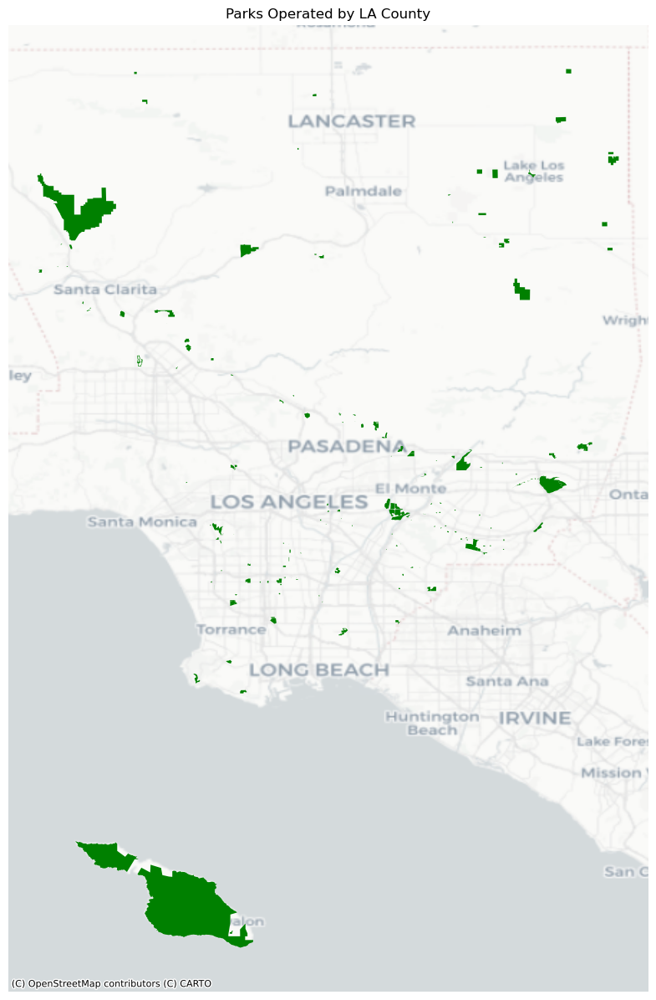

In [69]:
# start the plot in matplotlib.pyplot, then add the basemap from contextily
fig, ax = plt.subplots(figsize=(15, 15))

# add the data options...I don't think I technically have markers
county_parks.plot(ax=ax, 
        marker='X',
        markersize=2,
        color='green'
             )

ax.axis('off') # turn the axes off
ax.set_title('Parks Operated by LA County')

ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=4326) # note that we must specify the projection here (crs)

Well, I guess the unincorporated areas of Catalina Island have a lot of green space operated by the County, but I'm guessing not a lot of people actually live there.

At this point, I feel more confident in mapping (some types). Next week for our group project going into the midterm, I want to figure out how to overlay this parks map data over the low-income households in unincorporated LA data.

--- End of Week 4 Assignment ---